<a href="https://colab.research.google.com/github/swaroop-2007/Deep-Fake-Detection/blob/main/Bidirectional_LSTM_%2B_I3D.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
!pip install -q kaggle

In [4]:
from google.colab import files

In [5]:
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"swaroopudgaonkar","key":"87addd9b23aa578ed302bd9aeeb1c524"}'}

In [6]:
!mkdir ~/.kaggle

In [7]:
! cp kaggle.json ~/.kaggle/

In [8]:
! chmod 600 ~/.kaggle/kaggle.json

In [9]:
! kaggle datasets list

ref                                                              title                                             size  lastUpdated          downloadCount  voteCount  usabilityRating  
---------------------------------------------------------------  -----------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
rahulvyasm/netflix-movies-and-tv-shows                           Netflix Movies and TV Shows                        1MB  2024-04-10 09:48:38           7674        151  1.0              
aniketmahajan1104/indian-cities-electricity-consumption-2017-19  Indian Cities Electricity Consumption 2017-19      2KB  2024-04-24 09:34:25            627         23  1.0              
jaceprater/smokers-health-data                                   Smoker's Health Data                              29KB  2024-04-20 17:09:38           1468         24  1.0              
mexwell/heart-disease-dataset                                    🫀 Hea

In [10]:
! kaggle competitions download -c 'deepfake-detection-challenge'

100% 4.13G/4.13G [02:05<00:00, 32.5MB/s]
100% 4.13G/4.13G [02:05<00:00, 35.4MB/s]


In [11]:
! unzip deepfake-detection-challenge.zip

Archive:  deepfake-detection-challenge.zip
  inflating: sample_submission.csv   
  inflating: test_videos/aassnaulhq.mp4  
  inflating: test_videos/aayfryxljh.mp4  
  inflating: test_videos/acazlolrpz.mp4  
  inflating: test_videos/adohdulfwb.mp4  
  inflating: test_videos/ahjnxtiamx.mp4  
  inflating: test_videos/ajiyrjfyzp.mp4  
  inflating: test_videos/aktnlyqpah.mp4  
  inflating: test_videos/alrtntfxtd.mp4  
  inflating: test_videos/aomqqjipcp.mp4  
  inflating: test_videos/apedduehoy.mp4  
  inflating: test_videos/apvzjkvnwn.mp4  
  inflating: test_videos/aqrsylrzgi.mp4  
  inflating: test_videos/axfhbpkdlc.mp4  
  inflating: test_videos/ayipraspbn.mp4  
  inflating: test_videos/bcbqxhziqz.mp4  
  inflating: test_videos/bcvheslzrq.mp4  
  inflating: test_videos/bdshuoldwx.mp4  
  inflating: test_videos/bfdopzvxbi.mp4  
  inflating: test_videos/bfjsthfhbd.mp4  
  inflating: test_videos/bjyaxvggle.mp4  
  inflating: test_videos/bkcyglmfci.mp4  
  inflating: test_videos/bktkwbcawi.m

In [12]:
!pip install -U --upgrade tensorflow

In [13]:
# from tensorflow_docs.vis import embed
from tensorflow import keras
#from imutils import paths

import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
import numpy as np
import imageio
import cv2
import os

In [14]:
from google.colab import auth

auth.authenticate_user()

In [15]:
!curl https://sdk.cloud.google.com | bash

Streaming output truncated to the last 5000 lines.
google-cloud-sdk/lib/third_party/botocore/data/appsync/2017-07-25/service-2.json
google-cloud-sdk/lib/third_party/botocore/data/arc-zonal-shift/2022-10-30/endpoint-rule-set-1.json
google-cloud-sdk/lib/third_party/botocore/data/arc-zonal-shift/2022-10-30/paginators-1.json
google-cloud-sdk/lib/third_party/botocore/data/arc-zonal-shift/2022-10-30/service-2.json
google-cloud-sdk/lib/third_party/botocore/data/athena/2017-05-18/endpoint-rule-set-1.json
google-cloud-sdk/lib/third_party/botocore/data/athena/2017-05-18/paginators-1.json
google-cloud-sdk/lib/third_party/botocore/data/athena/2017-05-18/service-2.json
google-cloud-sdk/lib/third_party/botocore/data/auditmanager/2017-07-25/endpoint-rule-set-1.json
google-cloud-sdk/lib/third_party/botocore/data/auditmanager/2017-07-25/paginators-1.json
google-cloud-sdk/lib/third_party/botocore/data/auditmanager/2017-07-25/service-2.json
google-cloud-sdk/lib/third_party/botocore/data/autoscaling-plans

In [16]:
!gcloud init

Welcome! This command will take you through the configuration of gcloud.

Settings from your current configuration [default] are:
component_manager:
  disable_update_check: 'True'
core:
  account: swaroop.udgaonkar1@gmail.com

Pick configuration to use:
 [1] Re-initialize this configuration [default] with new settings 
 [2] Create a new configuration
Please enter your numeric choice:  1

Your current configuration has been set to: [default]

You can skip diagnostics next time by using the following flag:
  gcloud init --skip-diagnostics

Network diagnostic detects and fixes local network connection issues.
Reachability Check passed.
Network diagnostic passed (1/1 checks passed).

Choose the account you would like to use to perform operations for this 
configuration:
 [1] swaroop.udgaonkar1@gmail.com
 [2] Log in with a new account
Please enter your numeric choice:  1

You are logged in as: [swaroop.udgaonkar1@gmail.com].

Pick cloud project to use: 
 [1] braided-flow-420319
 [2] market-

In [17]:
!gsutil ls -l gs://deepfake_videos/

                                 gs://deepfake_videos/train_videos/


In [18]:
!gsutil -m cp -r gs://deepfake_videos/ .

Copying gs://deepfake_videos/train_videos/aaqaifqrwn.mp4...
Copying gs://deepfake_videos/train_videos/aassnaulhq.mp4...
Copying gs://deepfake_videos/train_videos/abebnhqyzv.mp4...
Copying gs://deepfake_videos/train_videos/aayrffkzxn.mp4...
Copying gs://deepfake_videos/train_videos/abhggqdift.mp4...
Copying gs://deepfake_videos/train_videos/acagallncj.mp4...
Copying gs://deepfake_videos/train_videos/abxtkdjyru.mp4...
Copying gs://deepfake_videos/train_videos/acdkfksyev.mp4...
Copying gs://deepfake_videos/train_videos/achdeirhym.mp4...
Copying gs://deepfake_videos/train_videos/acljesxipy.mp4...
Copying gs://deepfake_videos/train_videos/acryukkddn.mp4...
Copying gs://deepfake_videos/train_videos/adftmlvzfs.mp4...
Copying gs://deepfake_videos/train_videos/adwbthsgqb.mp4...
Copying gs://deepfake_videos/train_videos/aegvtnwqoe.mp4...
Copying gs://deepfake_videos/train_videos/aejvkfbtxs.mp4...
Copying gs://deepfake_videos/train_videos/aelsfznuqw.mp4...
Copying gs://deepfake_videos/train_video

In [19]:
#DATA_FOLDER = '../input/deepfake-detection-challenge'
TRAIN_SAMPLE_FOLDER = '/content/deepfake_videos/train_videos'
TEST_FOLDER = '/content/test_videos'

print(f"Train samples: {len(os.listdir(os.path.join(TRAIN_SAMPLE_FOLDER)))}")
print(f"Test samples: {len(os.listdir(os.path.join(TEST_FOLDER)))}")

Train samples: 3034
Test samples: 400


In [20]:
train_sample_metadata = pd.read_json('/content/deepfake_videos/train_videos/metadata.json').T
train_sample_metadata.head()

,label,split,original
owxbbpjpch.mp4,FAKE,train,wynotylpnm.mp4
vpmyeepbep.mp4,REAL,train,NaN
fzvpbrzssi.mp4,REAL,train,NaN
htorvhbcae.mp4,FAKE,train,wclvkepakb.mp4
fckxaqjbxk.mp4,FAKE,train,vpmyeepbep.mp4


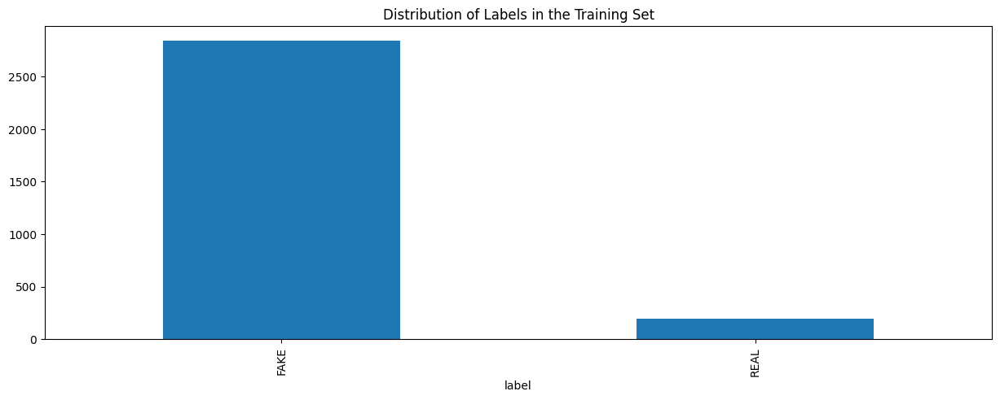

In [21]:
train_sample_metadata.groupby('label')['label'].count().plot(figsize=(15, 5), kind='bar', title='Distribution of Labels in the Training Set')
plt.show()

In [22]:
train_sample_metadata.shape

(3033, 3)

In [23]:
fake_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.label=='FAKE'].sample(3).index)
fake_train_sample_video

['neftqrxcgx.mp4', 'xenrrjivnr.mp4', 'kbmzfvrqep.mp4']

In [24]:
def display_image_from_video(video_path):
    '''
    input: video_path - path for video
    process:
    1. perform a video capture from the video
    2. read the image
    3. display the image
    '''
    capture_image = cv2.VideoCapture(video_path)
    ret, frame = capture_image.read()
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    ax.imshow(frame)

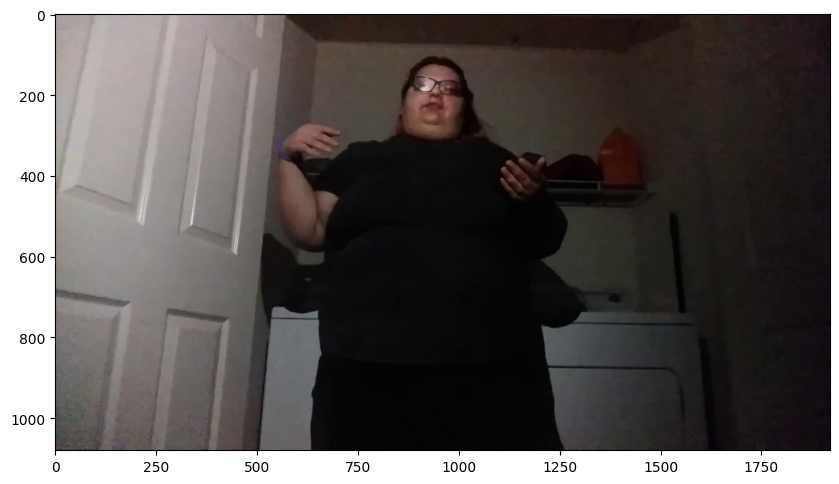

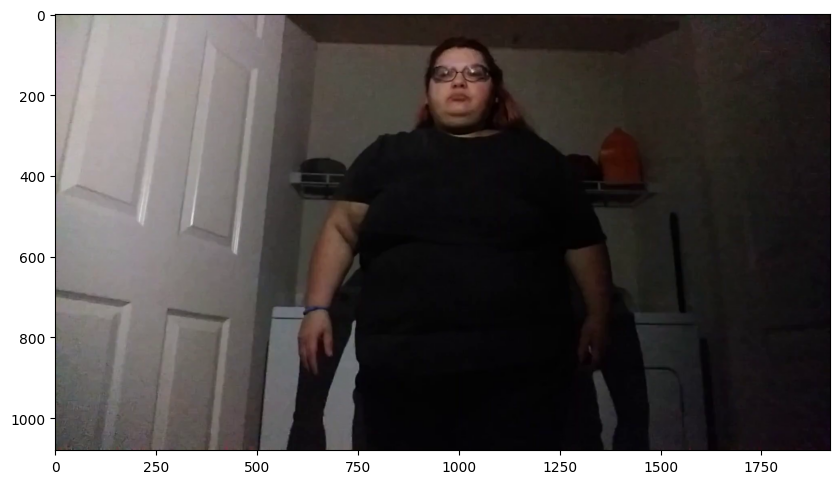

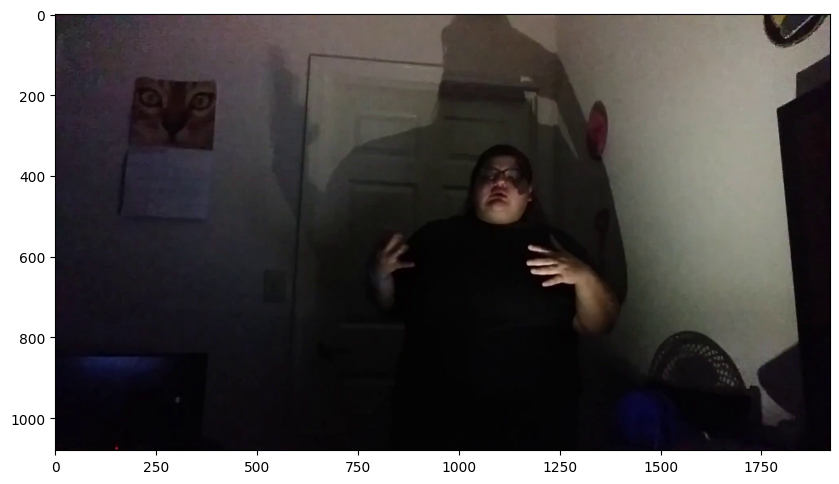

In [25]:
for video_file in fake_train_sample_video:
    display_image_from_video(os.path.join(TRAIN_SAMPLE_FOLDER, video_file))

In [26]:
real_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.label=='REAL'].sample(3).index)
real_train_sample_video

['gsshxchgqv.mp4', 'wfihvsniyz.mp4', 'psjfwjzrrh.mp4']

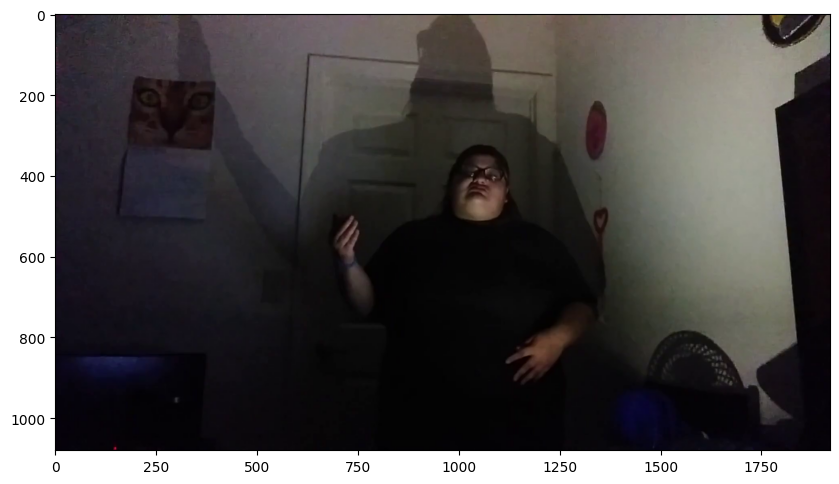

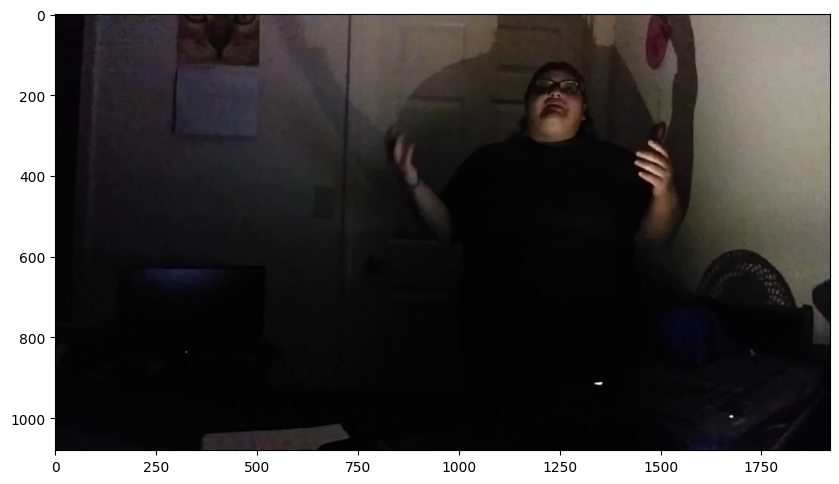

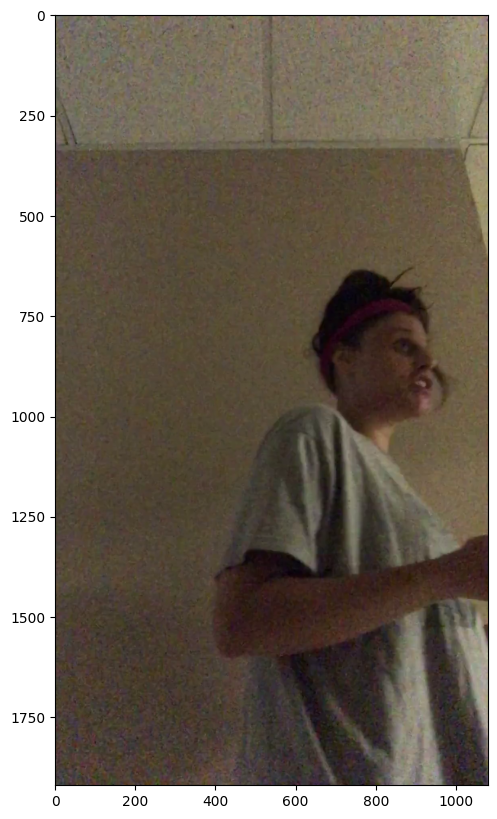

In [27]:
for video_file in real_train_sample_video:
    display_image_from_video(os.path.join(TRAIN_SAMPLE_FOLDER, video_file))

In [28]:
train_sample_metadata['original'].value_counts()[0:5]

original
fdpisghkmd.mp4    36
fnslimfagb.mp4    35
fneqiqpqvs.mp4    35
ywauoonmlr.mp4    34
wynotylpnm.mp4    34
Name: count, dtype: int64

In [29]:
def display_image_from_video_list(video_path_list, video_folder=TRAIN_SAMPLE_FOLDER):
    '''
    input: video_path_list - path for video
    process:
    0. for each video in the video path list
        1. perform a video capture from the video
        2. read the image
        3. display the image
    '''
    plt.figure()
    fig, ax = plt.subplots(2,3,figsize=(16,8))
    # we only show images extracted from the first 6 videos
    for i, video_file in enumerate(video_path_list[0:6]):
        video_path = os.path.join(video_folder,video_file)
        capture_image = cv2.VideoCapture(video_path)
        ret, frame = capture_image.read()
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        ax[i//3, i%3].imshow(frame)
        ax[i//3, i%3].set_title(f"Video: {video_file}")
        ax[i//3, i%3].axis('on')

<Figure size 640x480 with 0 Axes>

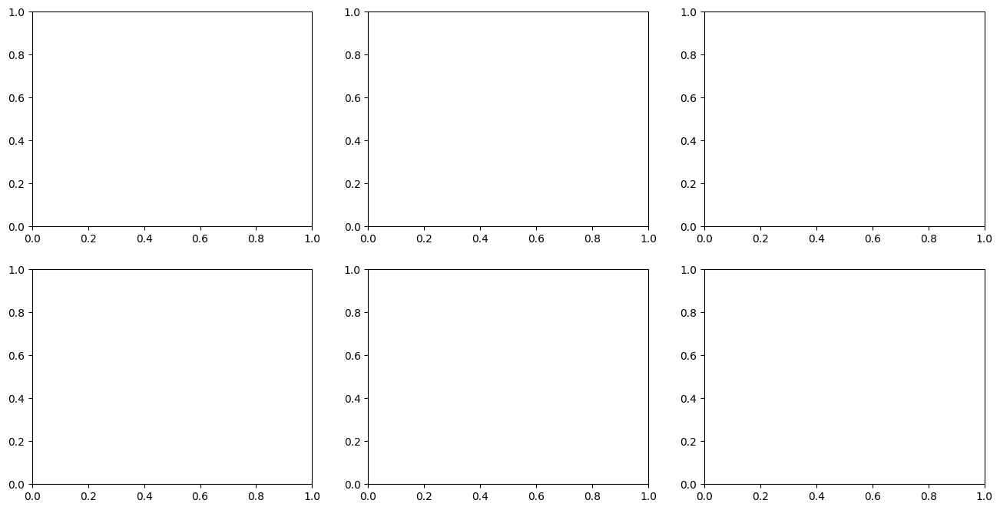

In [30]:
same_original_fake_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.original=='atvmxvwyns.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

In [31]:
test_videos = pd.DataFrame(list(os.listdir(os.path.join(TEST_FOLDER))), columns=['video'])

In [32]:
test_videos.head()

,video
0,udxqbhgvvx.mp4
1,oojxonbgow.mp4
2,wcssbghcpc.mp4
3,gbnzicjyhz.mp4
4,yhjlnisfel.mp4


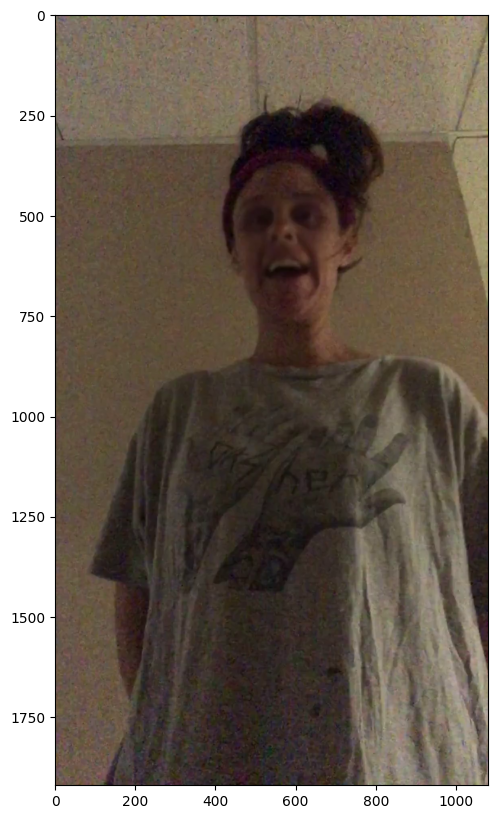

In [33]:
display_image_from_video(os.path.join(TEST_FOLDER, test_videos.iloc[2].video))

In [34]:
fake_videos = list(train_sample_metadata.loc[train_sample_metadata.label=='FAKE'].index)

In [35]:
from IPython.display import HTML
from base64 import b64encode

def play_video(video_file, subset=TRAIN_SAMPLE_FOLDER):
    '''
    Display video
    param: video_file - the name of the video file to display
    param: subset - the folder where the video file is located (can be TRAIN_SAMPLE_FOLDER or TEST_Folder)
    '''
    video_url = open(os.path.join(subset,video_file),'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(video_url).decode()
    return HTML("""<video width=500 controls><source src="%s" type="video/mp4"></video>""" % data_url)

play_video(fake_videos[10])

In [ ]:
IMG_SIZE = 224
BATCH_SIZE = 64
EPOCHS = 10

MAX_SEQ_LENGTH = 20
NUM_FEATURES = 2048

In [ ]:
def crop_center_square(frame):
    y, x = frame.shape[0:2]
    min_dim = min(y, x)
    start_x = (x // 2) - (min_dim // 2)
    start_y = (y // 2) - (min_dim // 2)
    return frame[start_y : start_y + min_dim, start_x : start_x + min_dim]


def load_video(path, max_frames=0, resize=(IMG_SIZE, IMG_SIZE)):
    cap = cv2.VideoCapture(path)
    frames = []
    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                break
            frame = crop_center_square(frame)
            frame = cv2.resize(frame, resize)
            frame = frame[:, :, [2, 1, 0]]
            frames.append(frame)

            if len(frames) == max_frames:
                break
    finally:
        cap.release()
    return np.array(frames)

In [ ]:
def build_feature_extractor():
    feature_extractor = keras.applications.InceptionV3(
        weights="imagenet",
        include_top=False,
        pooling="avg",
        input_shape=(IMG_SIZE, IMG_SIZE, 3),
    )
    preprocess_input = keras.applications.inception_v3.preprocess_input

    inputs = keras.Input((IMG_SIZE, IMG_SIZE, 3))
    preprocessed = preprocess_input(inputs)

    outputs = feature_extractor(preprocessed)
    return keras.Model(inputs, outputs, name="feature_extractor")


feature_extractor = build_feature_extractor()

In [ ]:
def prepare_all_videos(df, root_dir):
    num_samples = len(df)
    video_paths = list(df.index)
    labels = df["label"].values
    labels = np.array(labels=='FAKE').astype(int)

    # `frame_masks` and `frame_features` are what we will feed to our sequence model.
    # `frame_masks` will contain a bunch of booleans denoting if a timestep is
    # masked with padding or not.
    frame_masks = np.zeros(shape=(num_samples, MAX_SEQ_LENGTH), dtype="bool")
    frame_features = np.zeros(
        shape=(num_samples, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
    )

    # For each video.
    for idx, path in enumerate(video_paths):
        # Gather all its frames and add a batch dimension.
        frames = load_video(os.path.join(root_dir, path))
        frames = frames[None, ...]

        # Initialize placeholders to store the masks and features of the current video.
        temp_frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
        temp_frame_features = np.zeros(
            shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
        )

        # Extract features from the frames of the current video.
        for i, batch in enumerate(frames):
            video_length = batch.shape[0]
            length = min(MAX_SEQ_LENGTH, video_length)
            for j in range(length):
                temp_frame_features[i, j, :] = feature_extractor.predict(
                    batch[None, j, :]
                )
            temp_frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

        frame_features[idx,] = temp_frame_features.squeeze()
        frame_masks[idx,] = temp_frame_mask.squeeze()

    return (frame_features, frame_masks), labels

In [ ]:
from sklearn.model_selection import train_test_split

Train_set, Test_set = train_test_split(train_sample_metadata,test_size=0.1,random_state=42,stratify=train_sample_metadata['label'])

print(Train_set.shape, Test_set.shape )

In [ ]:
train_data, train_labels = prepare_all_videos(Train_set, "train")
test_data, test_labels = prepare_all_videos(Test_set, "test")

print(f"Frame features in train set: {train_data[0].shape}")
print(f"Frame masks in train set: {train_data[1].shape}")

In [ ]:
frame_features_input = keras.Input((MAX_SEQ_LENGTH, NUM_FEATURES))
mask_input = keras.Input((MAX_SEQ_LENGTH,), dtype="bool")

# Refer to the following tutorial to understand the significance of using `mask`:
# https://keras.io/api/layers/recurrent_layers/gru/
x = keras.layers.GRU(16, return_sequences=True)(
    frame_features_input, mask=mask_input
)
x = keras.layers.GRU(8)(x)
x = keras.layers.Dropout(0.4)(x)
x = keras.layers.Dense(8, activation="relu")(x)
output = keras.layers.Dense(1, activation="sigmoid")(x)

model = keras.Model([frame_features_input, mask_input], output)

model.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])
model.summary()

In [ ]:
checkpoint = keras.callbacks.ModelCheckpoint('.weights.h5', save_weights_only=True, save_best_only=True)
history = model.fit(
        [train_data[0], train_data[1]],
        train_labels,
        validation_data=([test_data[0], test_data[1]],test_labels),
        callbacks=[checkpoint],
        epochs=EPOCHS,
        batch_size=8
    )

In [ ]:
def prepare_single_video(frames):
    frames = frames[None, ...]
    frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
    frame_features = np.zeros(shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32")

    for i, batch in enumerate(frames):
        video_length = batch.shape[0]
        length = min(MAX_SEQ_LENGTH, video_length)
        for j in range(length):
            frame_features[i, j, :] = feature_extractor.predict(batch[None, j, :])
        frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

    return frame_features, frame_mask

def sequence_prediction(path):
    frames = load_video(os.path.join(TEST_FOLDER,path))
    frame_features, frame_mask = prepare_single_video(frames)
    return model.predict([frame_features, frame_mask])[0]

# This utility is for visualization.
# Referenced from:
# https://www.tensorflow.org/hub/tutorials/action_recognition_with_tf_hub
def to_gif(images):
    converted_images = images.astype(np.uint8)
    imageio.mimsave("animation.gif", converted_images, fps=10)
    return embed.embed_file("animation.gif")

In [ ]:
test_video = "/content/train_sample_videos/aelfnikyqj.mp4"
print(f"Test video path: {test_video}")

if(sequence_prediction(test_video)<=0.5):
    print(f'The predicted class of the video is FAKE')
else:
    print(f'The predicted class of the video is REAL')

play_video(test_video,TEST_FOLDER)

In [ ]:
test_video = "/content/train_sample_videos/ebkzwjgjhq.mp4"
print(f"Test video path: {test_video}")

if(sequence_prediction(test_video)<=0.5):
    print(f'The predicted class of the video is FAKE')
else:
    print(f'The predicted class of the video is REAL')


play_video(test_video,TEST_FOLDER)

### BiDirectional LSTM with I3D

In [36]:
!pip install -U --upgrade tensorflow

In [ ]:
pip uninstall keras

In [37]:
import tensorflow as tf
import numpy as np
import cv2
import os

In [38]:
def load_video(path, max_frames=20, resize=(224, 224)):
    cap = cv2.VideoCapture(path)
    frames = []
    try:
        while True:
            ret, frame = cap.read()
            if not ret or len(frames) == max_frames:
                break
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            frame = cv2.resize(frame, resize)
            frames.append(frame)
    finally:
        cap.release()
    return np.array(frames)

In [39]:
def build_i3d_model(input_shape=(224, 224, 3)):
    base_model = tf.keras.applications.InceptionV3(
        include_top=False,
        weights='imagenet',
        input_shape=input_shape,
        pooling='avg'
    )
    base_model.trainable = False
    inputs = tf.keras.Input(input_shape)
    x = tf.keras.applications.inception_v3.preprocess_input(inputs)
    x = base_model(x, training=False)
    return tf.keras.Model(inputs, x)

In [40]:
def extract_i3d_features(model, video_data):
    return model.predict(video_data)

In [41]:
def build_bidirectional_lstm_model(input_shape):
    inputs = tf.keras.layers.Input(shape=input_shape)
    x = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64, return_sequences=True))(inputs)
    x = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64))(x)
    x = tf.keras.layers.Dropout(0.5)(x)
    outputs = tf.keras.layers.Dense(1, activation='sigmoid')(x)
    model = tf.keras.models.Model(inputs, outputs)
    return model

In [42]:
i3d_model = build_i3d_model()

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


In [43]:
input_shape = (20, 2048)  # Assuming the output shape from I3D is (20, 2048)
model_bidirectional_lstm = build_bidirectional_lstm_model(input_shape)

In [44]:
model_bidirectional_lstm.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model_bidirectional_lstm.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)           │ (None, 20, 2048)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional (Bidirectional)        │ (None, 20, 128)             │       1,081,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_1 (Bidirectional)      │ (None, 128)                 │          98,816 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │             129 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,180,801 (4.50 MB)

 Trainable params: 1,180,801 (4.50 MB)

 Non-trainable params: 0 (0.00 B)

In [45]:
def prepare_data(video_folder, metadata):
    X, y = [], []
    for filename, row in metadata.iterrows():
        video_path = os.path.join(video_folder, filename)
        frames = load_video(video_path)
        features = extract_i3d_features(i3d_model, frames)
        X.append(features)
        y.append(row['label'] == 'FAKE')  # True for FAKE, False for REAL
    return np.array(X), np.array(y)

In [46]:
video_folder = '/content/deepfake_videos/train_videos'
metadata = pd.read_json('/content/deepfake_videos/train_videos/metadata.json').T
X_train, y_train = prepare_data(video_folder, metadata)

1/1 ━━━━━━━━━━━━━━━━━━━━ 11s 11s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━

In [50]:
history = model_bidirectional_lstm.fit(
    X_train, y_train,
    validation_split=0.1,
    epochs=20,
    batch_size=16
)

Epoch 1/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.9396 - loss: 0.2222 - val_accuracy: 0.9375 - val_loss: 0.2236
Epoch 2/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.9365 - loss: 0.2306 - val_accuracy: 0.9375 - val_loss: 0.2230
Epoch 3/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - accuracy: 0.9323 - loss: 0.2441 - val_accuracy: 0.9375 - val_loss: 0.2261
Epoch 4/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.9377 - loss: 0.2245 - val_accuracy: 0.9375 - val_loss: 0.2196
Epoch 5/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.9339 - loss: 0.2399 - val_accuracy: 0.9375 - val_loss: 0.2279
Epoch 6/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.9386 - loss: 0.2295 - val_accuracy: 0.9375 - val_loss: 0.2190
Epoch 7/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.9305 - loss: 0.2429 - val_accuracy: 0.9375 - val_loss: 0.2251
Epoch 8/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - accuracy: 0.9385 - loss: 0.2234 - val_accu

In [48]:
def sequence_prediction(path):
    frames = load_video(path)
    features = extract_i3d_features(i3d_model, frames)
    prediction = model_bidirectional_lstm.predict(features[None, ...])
    return 'FAKE' if prediction[0, 0] > 0.5 else 'REAL'


In [49]:
test_video_1 = "/content/train_sample_videos/aelfnikyqj.mp4"
print(f"Test video path: {test_video_1}")
print(f'The predicted class of the video is: {sequence_prediction(test_video_1)}')

test_video_2 = "/content/train_sample_videos/ebkzwjgjhq.mp4"
print(f"Test video path: {test_video_2}")
print(f'The predicted class of the video is: {sequence_prediction(test_video_2)}')

Test video path: /content/train_sample_videos/aelfnikyqj.mp4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
The predicted class of the video is: FAKE
Test video path: /content/train_sample_videos/ebkzwjgjhq.mp4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
The predicted class of the video is: FAKE
